# ジオコーディング
ジオコーディングにより，住所から，ジオメトリオブジェクトを得ることができる。
Pythonでジオコーディングを実行するパッケージとして，`geopy`がある。

In [1]:
!pip install pandas

In [2]:
!pip install geopy

In [3]:
import pandas as pd
import geopy
#見つけたい場所をname列として指定する。
df = pd.DataFrame({'name': [u'東京', u'大阪', u'福岡',u'青山学院大学']})

from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="gis2021")

#エラー応答の設定
from geopy.extra.rate_limiter import RateLimiter
geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
#エラー応答の設定

#ジオコーディングにより， 住所に対応するオブジェクトを見つけてlocation列に入れる
df['location'] = df['name'].apply(geocode)
#それぞれの場所（行）に対して，その点を取り出してpoint列に入れる
df['point'] = df['location'].apply(lambda loc: tuple(loc.point) if loc else None)

print(df['location'])
print("")
print(df['point'])

0                 (東京都, 日本, (35.6828387, 139.7594549))
1    (大阪, 中央コンコース, 梅田三丁目, 北区, 大阪市, 大阪府, 530-0001, 日...
2            (福岡市, 福岡県, 日本, (33.5898988, 130.4017509))
3    (青山学院大学, 首都高速3号渋谷線, 広尾三丁目, 渋谷四丁目, 渋谷区, 東京都, 15...
Name: location, dtype: object

0           (35.6828387, 139.7594549, 0.0)
1           (34.7021912, 135.4955866, 0.0)
2           (33.5898988, 130.4017509, 0.0)
3    (35.6605744, 139.71041617758044, 0.0)
Name: point, dtype: object


ファイルを用いて複数の地点をジオコーディングする。

In [4]:
!pip install geopandas

In [7]:
import geopandas as gpd
from shapely.geometry import Point
fp=r"data/address1.txt"
data=pd.read_csv(fp)

In [8]:
data

,name,address
0,東京駅,東京都千代田区丸の内１丁目
1,大阪駅,大阪府大阪市北区梅田３丁目１−１
2,博多駅,福岡県福岡市博多区博多駅中央街１−１
3,青山学院大学,東京都渋谷区渋谷４丁目４−２５
4,青山学院大学相模原キャンパス,神奈川県相模原市中央区淵野辺5-10-1


In [9]:
#ジオコーディングにより， 住所に対応するオブジェクトを見つけてlocation列に入れる
data['location'] = data['address'].apply(geocode)
data

,name,address,location
0,東京駅,東京都千代田区丸の内１丁目,None
1,大阪駅,大阪府大阪市北区梅田３丁目１−１,None
2,博多駅,福岡県福岡市博多区博多駅中央街１−１,None
3,青山学院大学,東京都渋谷区渋谷４丁目４−２５,None
4,青山学院大学相模原キャンパス,神奈川県相模原市中央区淵野辺5-10-1,None


`geopy`の機能は，`geopandas`から間接的に用いることもできる。

In [10]:
# Import the geocoding tool
from geopandas.tools import geocode
#geo = geocode(data['location'], provider='nominatim', user_agent='gis2021', timeout=4)
geo = geocode(data['name'], provider='nominatim', user_agent='gis2021', timeout=4)

In [11]:
geo

,geometry,address
0,POINT (139.76876 35.68063),"東京駅, タクシー・一般車降車場(タクシー用), 丸の内1, 丸の内, 千代田区, 東京都,..."
1,POINT (135.49604 34.70245),"大阪駅, 国道176号, 角田町, 北区, 大阪市, 大阪府, 530-0017, 日本"
2,POINT (130.42108 33.58957),"博多駅, 筑紫通り, 博多駅中央街, 博多区, 福岡市, 福岡県, 812-0013, 日本"
3,POINT (139.71042 35.66057),"青山学院大学, 首都高速3号渋谷線, 広尾三丁目, 渋谷四丁目, 渋谷区, 東京都, 150..."
4,POINT (139.40255 35.56652),"青山学院大学 相模原キャンパス, 芝溝街道, 淵野辺本町, 中央区, 相模原市, 神奈川県,..."


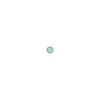

In [12]:
geo.at[0,'geometry']

東京付近のみの場所を扱うことにして，address2.txtを読み込む。

In [13]:
fp=r"data/address2.txt"
data_tokyo=pd.read_csv(fp)

In [14]:
data_tokyo

,name,address
0,東京駅,東京都千代田区丸の内１丁目
1,青山学院大学,東京都渋谷区渋谷４丁目４−２５
2,青山学院大学相模原キャンパス,神奈川県相模原市中央区淵野辺5-10-1
3,町田駅,東京都町田市原町田６丁目１２−２０


In [15]:
geo_tokyo = geocode(data_tokyo['name'], provider='nominatim', user_agent='gis2021', timeout=4)

In [16]:
geo_tokyo

,geometry,address
0,POINT (139.76876 35.68063),"東京駅, タクシー・一般車降車場(タクシー用), 丸の内1, 丸の内, 千代田区, 東京都,..."
1,POINT (139.71042 35.66057),"青山学院大学, 首都高速3号渋谷線, 広尾三丁目, 渋谷四丁目, 渋谷区, 東京都, 150..."
2,POINT (139.40255 35.56652),"青山学院大学 相模原キャンパス, 芝溝街道, 淵野辺本町, 中央区, 相模原市, 神奈川県,..."
3,POINT (139.44524 35.54595),"町田駅, 栄通り, 原町田6, 町田市, 東京都, 194-8550, 日本"


## 地図の描画
これらの点を，東京都の地図の上に重ねる。

In [17]:
!wget https://raw.githubusercontent.com/dataofjapan/land/master/tokyo.geojson

--2021-05-16 18:58:17--  https://raw.githubusercontent.com/dataofjapan/land/master/tokyo.geojson
raw.githubusercontent.com (raw.githubusercontent.com) をDNSに問いあわせています... 185.199.109.133, 185.199.110.133, 185.199.111.133, ...
raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443 に接続しています... 接続しました。
HTTP による接続要求を送信しました、応答を待っています... 200 OK
長さ: 6611773 (6.3M) [text/plain]
`tokyo.geojson.1' に保存中

tokyo.geojson.1     100%[===================>]   6.30M  1.73MB/s 時間 3.8s       

2021-05-16 18:58:22 (1.66 MB/s) - `tokyo.geojson.1' へ保存完了 [6611773/6611773]



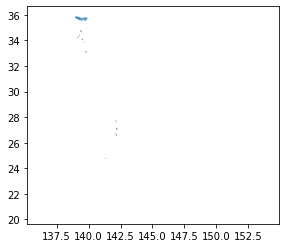

In [20]:
!pip install matplotlib
import matplotlib.pyplot as plt
tokyo=gpd.read_file("data/tokyo.geojson")
tokyo.plot()

島嶼部を取り除くために，データフレームから都区部と多摩の行を抜き出す。

In [21]:
tokyo

,ward_ja,ward_en,area_ja,area_en,code,geometry
0,足立区,Adachi Ku,都区部,Tokubu,131211.0,"POLYGON ((139.82105 35.81508, 139.82168 35.814..."
1,文京区,Bunkyo Ku,都区部,Tokubu,131059.0,"POLYGON ((139.76093 35.73221, 139.76100 35.732..."
2,千代田区,Chiyoda Ku,都区部,Tokubu,131016.0,"POLYGON ((139.77014 35.70535, 139.77017 35.705..."
3,台東区,Taito Ku,都区部,Tokubu,131067.0,"POLYGON ((139.80971 35.72814, 139.80971 35.727..."
4,品川区,Shinagawa Ku,都区部,Tokubu,131091.0,"MULTIPOLYGON (((139.71920 35.64185, 139.71935 ..."
...,...,...,...,...,...,...
58,大島町,Oshima Machi,島嶼部,Toushobu,133612.0,"MULTIPOLYGON (((139.36026 34.79860, 139.36025 ..."
59,青梅市,Ome Shi,多摩,Tama,132055.0,"POLYGON ((139.22923 35.83766, 139.22958 35.837..."
60,武蔵野市,Musashino Shi,多摩,Tama,132039.0,"POLYGON ((139.58665 35.71191, 139.58679 35.711..."
61,あきる野市,Akiruno Shi,多摩,Tama,132284.0,"POLYGON ((139.16304 35.77824, 139.16350 35.777..."


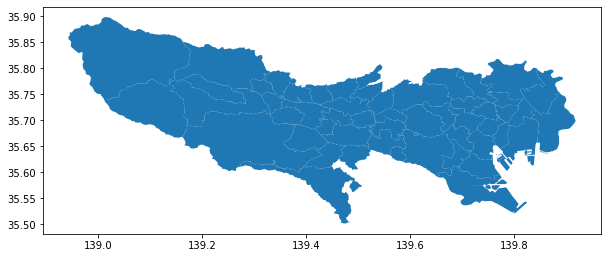

In [22]:
tokyo = tokyo[[v in ('都区部', '多摩') for v in tokyo['area_ja']]]
tokyo.plot(figsize=(10,10))

In [23]:
machida=tokyo.loc[tokyo['ward_ja']=='町田市']

In [24]:
machida

,ward_ja,ward_en,area_ja,area_en,code,geometry
56,町田市,Machida Shi,多摩,Tama,132098.0,"POLYGON ((139.26880 35.60935, 139.26889 35.609..."


In [25]:
machida.reset_index(drop=True,inplace=True)
machida

,ward_ja,ward_en,area_ja,area_en,code,geometry
0,町田市,Machida Shi,多摩,Tama,132098.0,"POLYGON ((139.26880 35.60935, 139.26889 35.609..."


In [26]:
print(tokyo['geometry'].head())
print(machida['geometry'].head())
print(geo_tokyo['geometry'].head())

0    POLYGON ((139.82105 35.81508, 139.82168 35.814...
1    POLYGON ((139.76093 35.73221, 139.76100 35.732...
2    POLYGON ((139.77014 35.70535, 139.77017 35.705...
3    POLYGON ((139.80971 35.72814, 139.80971 35.727...
4    MULTIPOLYGON (((139.71920 35.64185, 139.71935 ...
Name: geometry, dtype: geometry
0    POLYGON ((139.26880 35.60935, 139.26889 35.609...
Name: geometry, dtype: geometry
0    POINT (139.76876 35.68063)
1    POINT (139.71042 35.66057)
2    POINT (139.40255 35.56652)
3    POINT (139.44524 35.54595)
Name: geometry, dtype: geometry


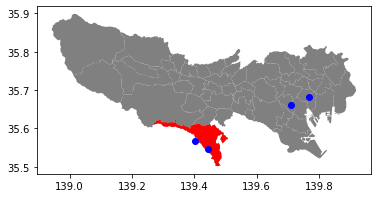

In [27]:
fig,ax=plt.subplots()
tokyo.plot(ax=ax,facecolor='grey')
machida.plot(ax=ax,facecolor='red')
geo_tokyo.plot(ax=ax,facecolor='blue')

## Geometryオブジェクトの操作


tokyoの行のgeometryとして，複数のShapelyオブジェクトが設定されている場合がある。

In [28]:
tokyo.loc[tokyo['ward_ja']=="品川区"]

,ward_ja,ward_en,area_ja,area_en,code,geometry
4,品川区,Shinagawa Ku,都区部,Tokubu,131091.0,"MULTIPOLYGON (((139.71920 35.64185, 139.71935 ..."


このような場合は，区または市全体を表す一つのポリゴンがあると便利である。このためには，`convex_hull`を用いて凸包を求めるとよい。

In [29]:
tokyo["convex_hull"]=tokyo.convex_hull
tokyo["boundary"]=tokyo.boundary

/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


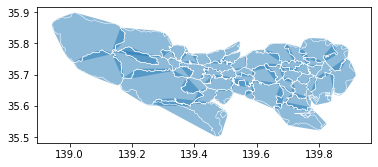

In [30]:
ax=tokyo["convex_hull"].plot(alpha=.5) #透明度を0.5とする。
tokyo["boundary"].plot(ax=ax,color="white",linewidth=.5)

また，重心を表すポイントを設定しておく。

/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


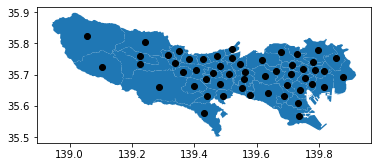

In [31]:
tokyo["centroid"]=tokyo.centroid
ax = tokyo["geometry"].plot()
tokyo["centroid"].plot(ax=ax, color="black")

In [32]:
# buffering the active geometry by 10 000 feet (geometry is already in feet)
tokyo["buffered"] = tokyo.buffer(10000)
# buffering the centroid geometry by 10 000 feet (geometry is already in feet)
tokyo["buffered_centroid"] = tokyo["centroid"].buffer(10000)

/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [33]:
tokyo["buffered"]=tokyo.buffer(0.01)
tokyo["buffered_centroid"]=tokyo["centroid"].buffer(0.01)

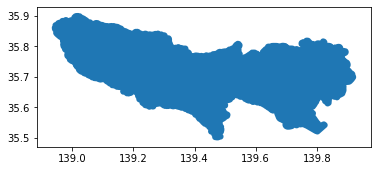

In [34]:
ax=tokyo["buffered"].plot()
tokyo["boundary"].plot(ax=ax)

In [35]:
tama=tokyo.loc[tokyo['ward_ja']=='多摩市']
#machida=tokyo.loc[tokyo['ward_ja']=='町田市']
tama.reset_index(drop=True,inplace=True)

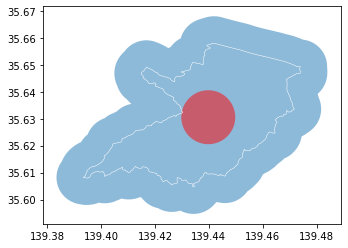

In [36]:
ax=tama["buffered"].plot(alpha=.5)#透明度を.5とする。
tama["boundary"].plot(ax=ax,color="white",linewidth=.5)
tama["buffered_centroid"].plot(ax=ax,color="red",alpha=.5)

## 近接関係の判定

多摩市と町田は一定のバッファー内にあるかどうかを確認するには次のようにする。

In [37]:
print(tama["buffered"].intersects(machida))
print(tama["buffered_centroid"].intersects(machida))

0    True
dtype: bool
0    False
dtype: bool


町田市は，多摩市の境界から一定のバッファー内にあり，多摩市の重心から一定範囲内にはない，ということがわかる。これを描画して確認するものが次のプログラムである。

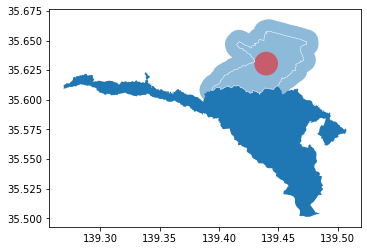

In [38]:
ax=tama["buffered"].plot(alpha=.5)#透明度を.5とする。
tama["boundary"].plot(ax=ax,color="white",linewidth=.5)
tama["buffered_centroid"].plot(ax=ax,color="red",alpha=.5)
machida["geometry"].plot(ax=ax)

## 神奈川県

In [50]:
kanagawa_infp="data/N03-20200101_14_GML/N03-20_14_200101.geojson"
#infp="data/N03-20_200101.geojson"
kanagawa=gpd.read_file(kanagawa_infp)

全国の地図データを読み込む

In [43]:
japan=gpd.read_file(infp)

都道府県を表すカラム`N03_001`の値が神奈川県であるデータを抜き出し，それらのカラム`N03_004`のデータとして出てくる値を表示する。

In [53]:
japan[ japan['N03_001']=='神奈川県' ]['N03_004'].unique()

array(['鶴見区', '神奈川区', '西区', '中区', '南区', '保土ケ谷区', '磯子区', '金沢区', '港北区',
       '戸塚区', '港南区', '旭区', '緑区', '瀬谷区', '栄区', '泉区', '青葉区', '都筑区', '川崎区',
       '幸区', '中原区', '高津区', '多摩区', '宮前区', '麻生区', '中央区', '横須賀市', '平塚市',
       '鎌倉市', '藤沢市', '小田原市', '茅ヶ崎市', '逗子市', '三浦市', '秦野市', '厚木市', '大和市',
       '伊勢原市', '海老名市', '座間市', '南足柄市', '綾瀬市', '葉山町', '寒川町', '大磯町', '二宮町',
       '中井町', '大井町', '松田町', '山北町', '開成町', '箱根町', '真鶴町', '湯河原町', '愛川町',
       '清川村'], dtype=object)

In [54]:
kanagawa['N03_004'].unique()

array(['鶴見区', '神奈川区', '西区', '中区', '南区', '保土ケ谷区', '磯子区', '金沢区', '港北区',
       '戸塚区', '港南区', '旭区', '緑区', '瀬谷区', '栄区', '泉区', '青葉区', '都筑区', '川崎区',
       '幸区', '中原区', '高津区', '多摩区', '宮前区', '麻生区', '中央区', '横須賀市', '平塚市',
       '鎌倉市', '藤沢市', '小田原市', '茅ヶ崎市', '逗子市', '三浦市', '秦野市', '厚木市', '大和市',
       '伊勢原市', '海老名市', '座間市', '南足柄市', '綾瀬市', '葉山町', '寒川町', '大磯町', '二宮町',
       '中井町', '大井町', '松田町', '山北町', '開成町', '箱根町', '真鶴町', '湯河原町', '愛川町',
       '清川村'], dtype=object)

In [55]:
kanagawa.columns

Index(['N03_001', 'N03_002', 'N03_003', 'N03_004', 'N03_007', '_color',
       '_opacity', '_weight', '_fillColor', '_fillOpacity', 'geometry'],
      dtype='object')

神奈川県の行政区域をプロットする。

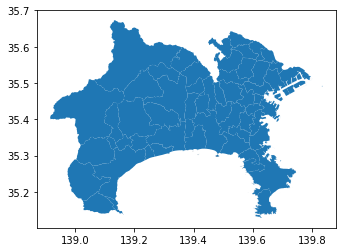

In [56]:
kanagawa.plot()

# 洪水浸水想定区域データ
洪水浸水想定区域データを用いて，洪水時の浸水の様子を可視化する。下記のURLにあるデータを用いる。
https://nlftp.mlit.go.jp/ksj/gml/datalist/KsjTmplt-A31-v2_1.html#prefecture14
このページの「神奈川県」のデータをダウンロードして展開した中の，geojsonファイルを用いる。    

In [98]:
ookagawafp="data/A31-20_14_GML/A31-20-20_14-002-大岡川.geojson"
ookagawa=gpd.read_file(ookagawafp)
karigawafp="data/A31-20_14_GML/A31-20-20_14-019-狩川（要定川・洞川）.geojson"
karigawa=gpd.read_file(karigawafp)
sannogawafp="data/A31-20_14_GML/A31-20-20_14-020-山王川.geojson"
sannogawa=gpd.read_file(sannogawafp)

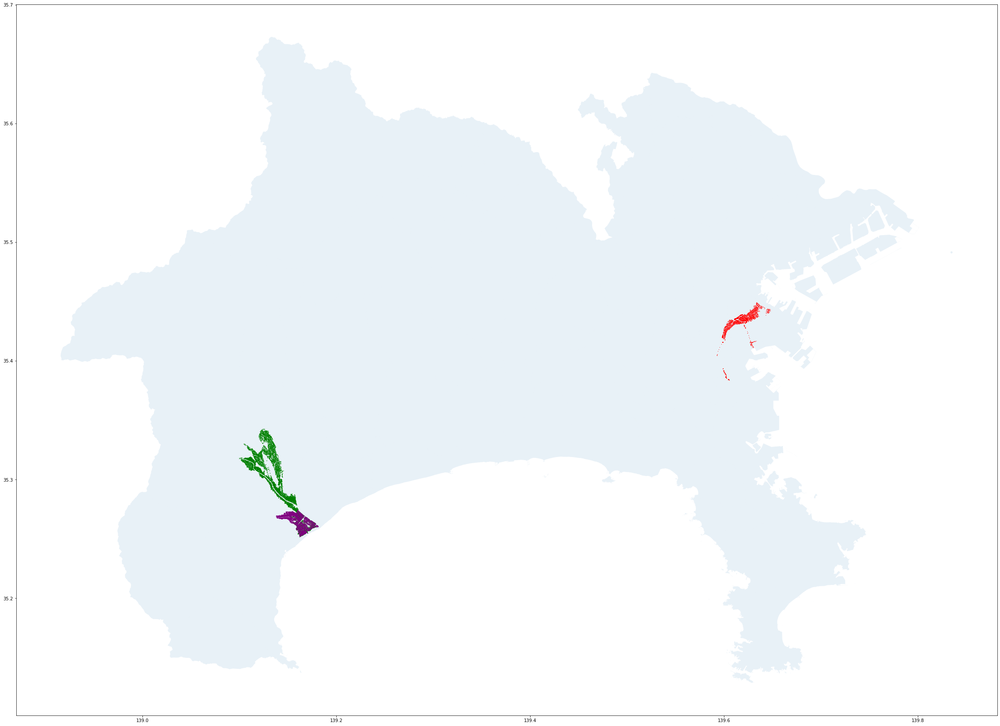

In [99]:
ax=kanagawa.plot(alpha=0.1,figsize=(40,40))
#ax=kanagawa.boundary.plot()
ookagawa.plot(ax=ax,color="red",legend=True)
karigawa.plot(ax=ax,color="green",legend=True)
sannogawa.plot(ax=ax,color="purple",legend=True)

洪水浸水想定区域を示すデータフレームには，`A31_201`に浸水深ランクが含まれている。

In [100]:
ookagawa["A31_201"]

0       1
1       1
2       1
3       1
4       1
       ..
2009    3
2010    3
2011    3
2012    3
2013    3
Name: A31_201, Length: 2014, dtype: int64

これらの値の大小を，色で区別してプロットすると，次のようになる。

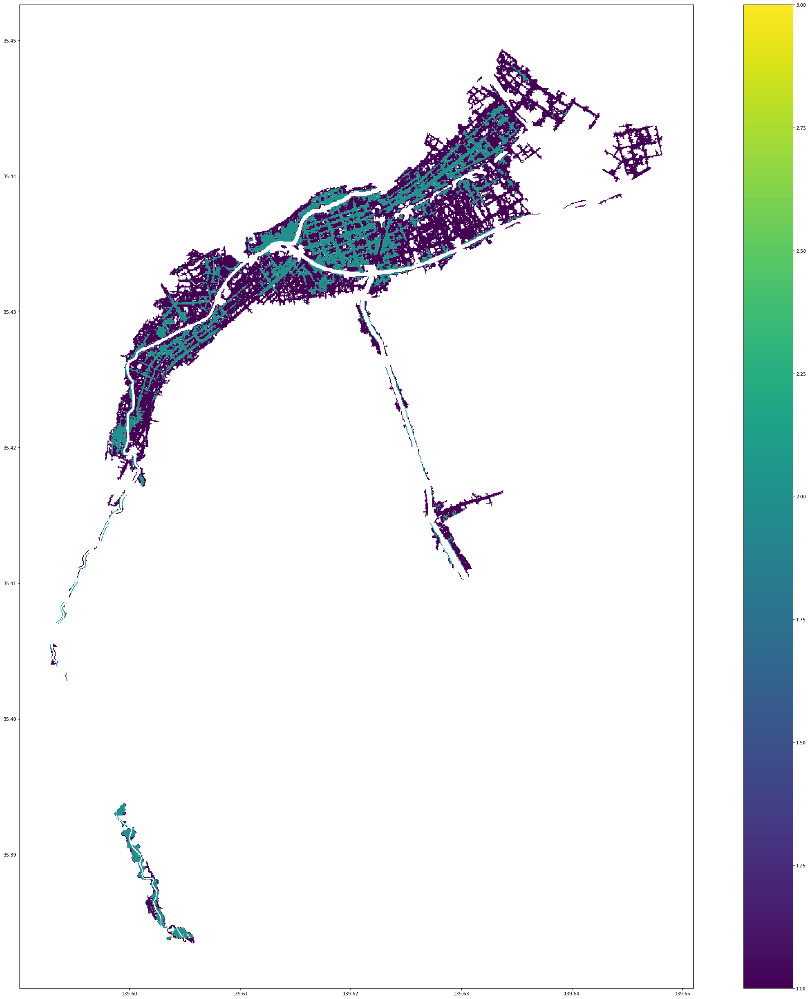

In [101]:
ookagawa.plot("A31_201",legend=True,figsize=(40,40))

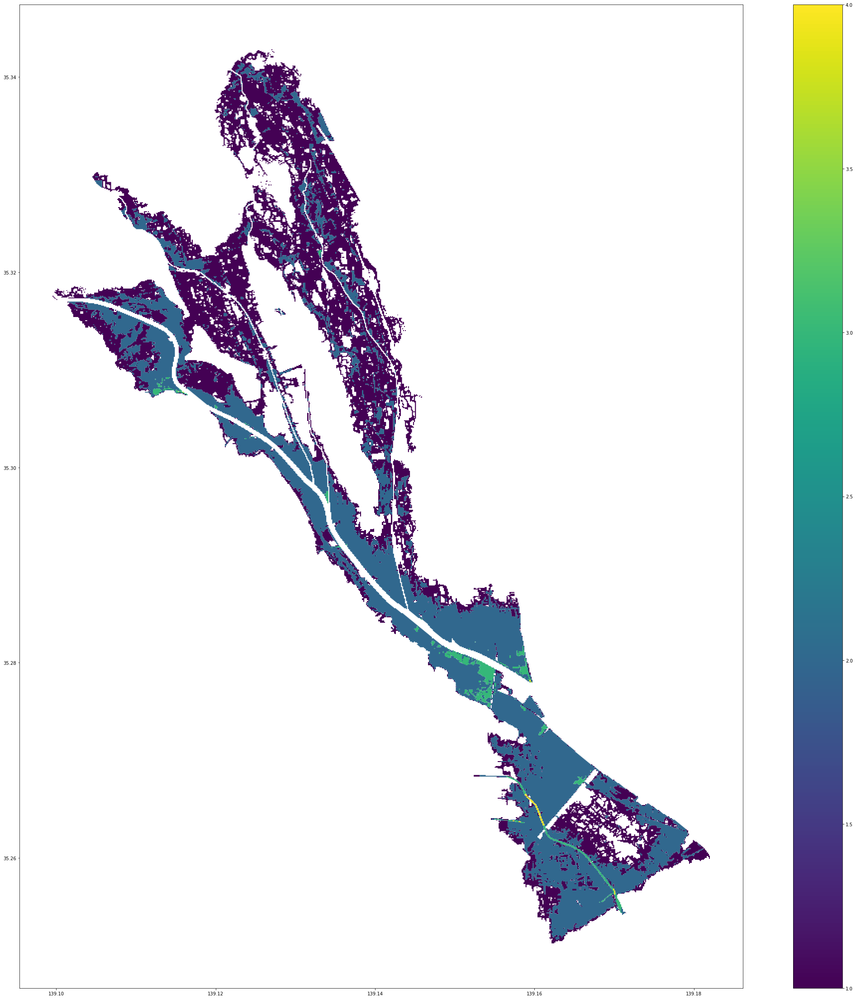

In [102]:
karigawa.plot("A31_201",legend=True,figsize=(40,40))

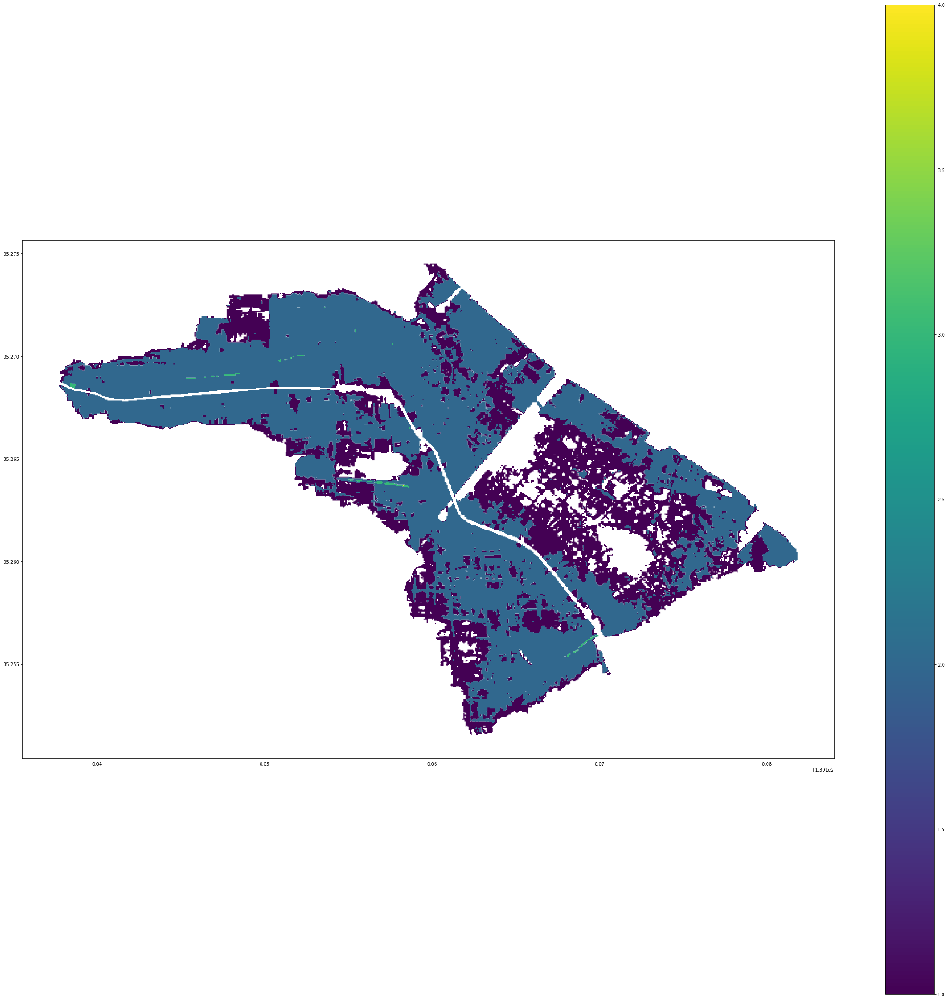

In [103]:
sannogawa.plot("A31_201",legend=True,figsize=(40,40))


# 津波浸水想定データ


In [157]:
kanagawa_tsunamifp="data/A40-16_14_GML/A40-16_14.shp"
#infp="data/N03-20_200101.geojson"
kanagawa_tsunami=gpd.read_file(kanagawa_tsunamifp)

In [160]:
kanagawa_tsunami.columns

Index(['A40_001', 'A40_002', 'A40_003', 'geometry'], dtype='object')

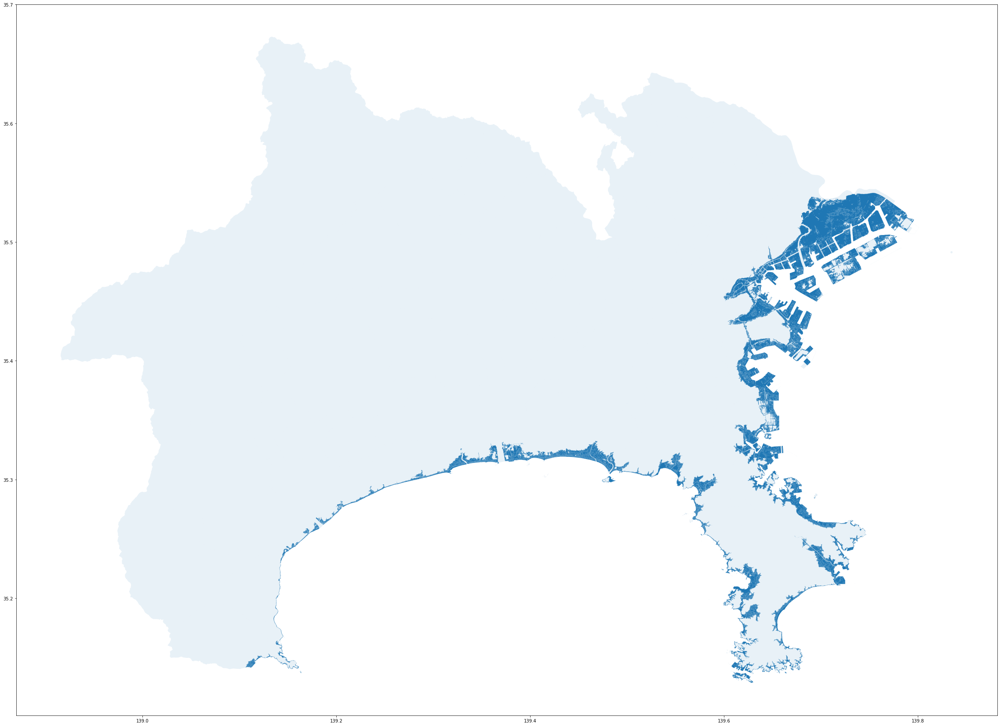

In [166]:
ax=kanagawa.plot(alpha=0.1,figsize=(40,40))
kanagawa_tsunami.plot(ax=ax)

/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 20197 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 19978 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 12316 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 26410 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 28288 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/kazuhiro/opt/anaconda3/lib/python3.8/site-p

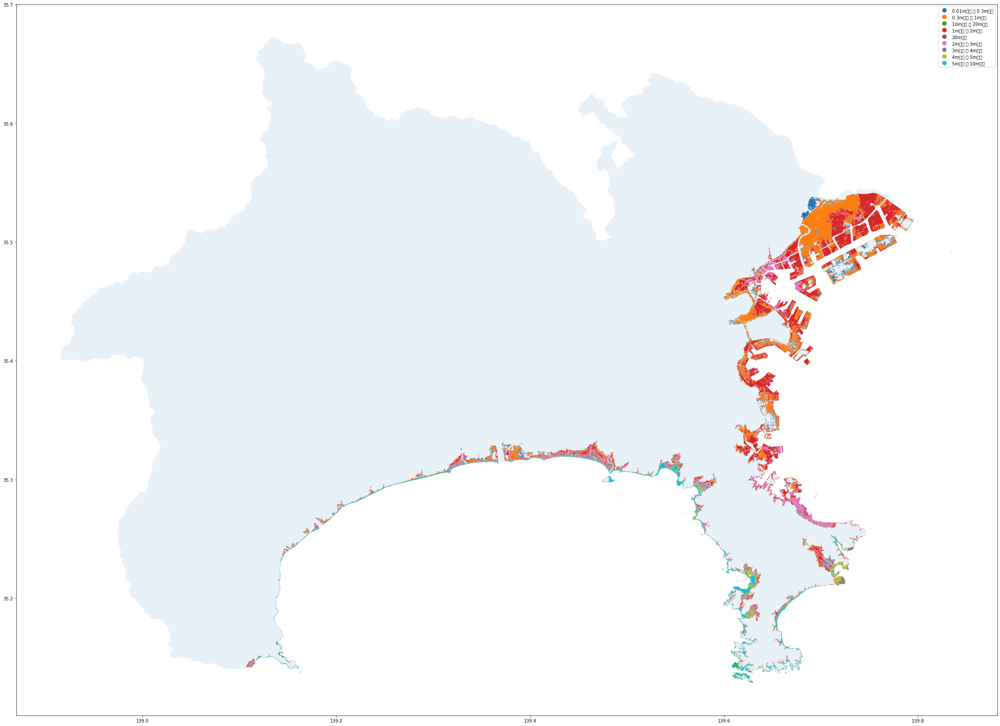

In [165]:
ax=kanagawa.plot(alpha=0.1,figsize=(40,40))
kanagawa_tsunami.plot(column="A40_003",ax=ax,legend=True)

In [163]:
kanagawa_tsunami.columns

Index(['A40_001', 'A40_002', 'A40_003', 'geometry'], dtype='object')

# 地価公示データ

地価公示データを重ねてプロットする。

In [139]:
!pip install mapclassify
import mapclassify
import folium

In [107]:
chika_kanagawafp="data/L01-21_14_GML/L01-21_14_GML\L01-21_14.geojson"
chika_kanagawa=gpd.read_file(chika_kanagawafp)
chika_kanagawa.columns

Index(['L01_001', 'L01_002', 'L01_003', 'L01_004', 'L01_005', 'L01_006',
       'L01_007', 'L01_008', 'L01_009', 'L01_010',
       ...
       'L01_124', 'L01_125', 'L01_126', 'L01_127', 'L01_128', 'L01_129',
       'L01_130', 'L01_131', 'L01_132', 'geometry'],
      dtype='object', length=133)

カラムのうち， L01_094は令和3年の調査価格，L01_021は標準地行政区域コードである。ここでは，小田原市の14206を用いる。

In [129]:
chika_odawara=chika_kanagawa[chika_kanagawa["L01_021"]=="14206"]

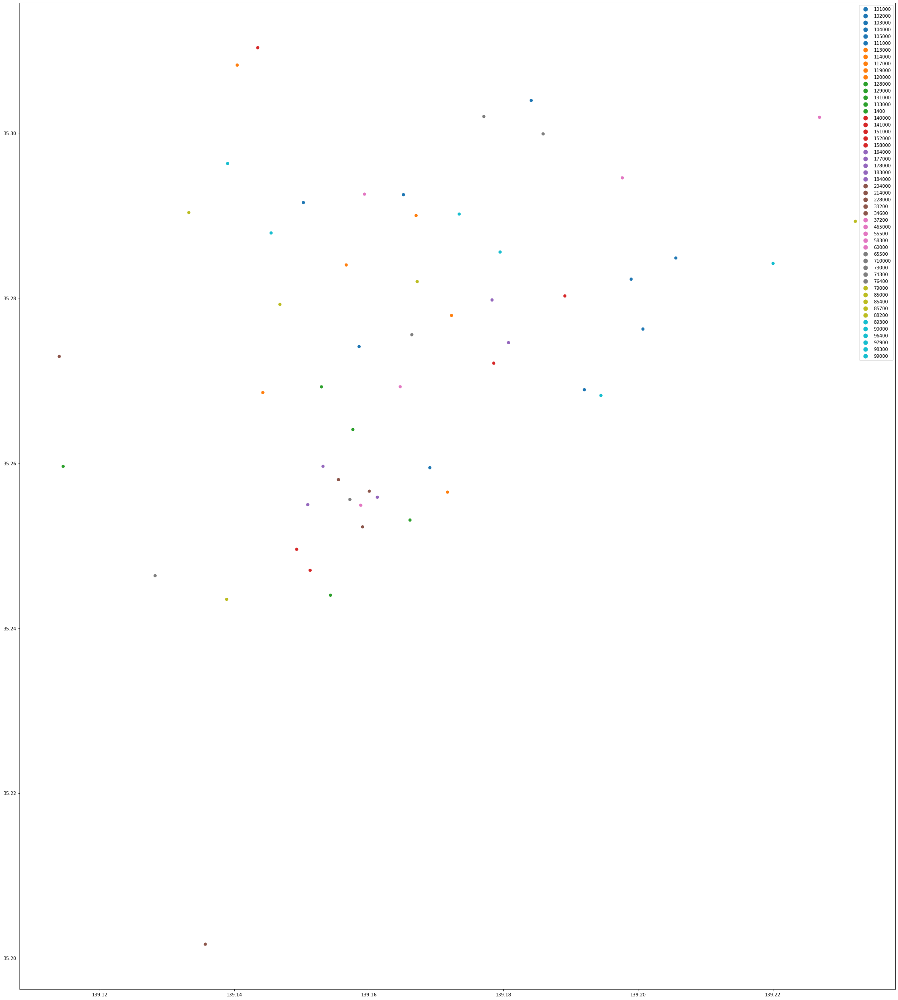

In [136]:
chika_odawara.plot("L01_094",k=10,legend=True,figsize=(40,40))

## Folium

In [155]:
m2=folium.Map(location=[35.2567557,139.1554675])
folium.GeoJson(kanagawa_infp,name="geojson").add_to(m2)
folium.GeoJson(chika_kanagawafp,name="geojson").add_to(m2)


In [156]:
m2

In [154]:
chika_odawara

,L01_001,L01_002,L01_003,L01_004,L01_005,L01_006,L01_007,L01_008,L01_009,L01_010,...,L01_124,L01_125,L01_126,L01_127,L01_128,L01_129,L01_130,L01_131,L01_132,geometry
1344,000,001,000,001,2021,73000,1,false,false,false,...,10000010000000,20000000000000,10000000000000,10000000000000,10000000000000,10000000000000,11000000000000,10000000000000,10000000000000,POINT (139.17707 35.30201)
1345,000,002,000,002,2021,88200,1,false,false,false,...,10000000000000,20000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.14677 35.27923)
1346,000,003,000,003,2021,120000,1,false,false,false,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.17227 35.27789)
1347,000,004,000,004,2021,101000,1,false,false,false,...,40000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.19201 35.26889)
1348,000,005,000,005,2021,85700,1,false,false,false,...,40000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.16717 35.28200)
1349,000,006,000,006,2021,102000,1,false,false,false,...,20000010000000,20000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.19896 35.28229)
1350,000,007,000,007,2021,89300,1,false,false,false,...,10000010000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.19447 35.26819)
1351,000,008,000,008,2021,128000,1,false,false,false,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.15294 35.26923)
1352,000,009,000,009,2021,129000,1,false,false,false,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.15761 35.26406)
1353,000,010,000,010,2021,177000,1,false,false,false,...,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,10000000000000,POINT (139.15317 35.25960)


標高データを用いるには， http://cyberjapandata.gsi.go.jp/xyz/dem/{x}/{y}/{z}.txtのxyzにタイル番号を入れるとよい。 参照URL:http://memomemokun.hateblo.jp/entry/2018/11/01/221545

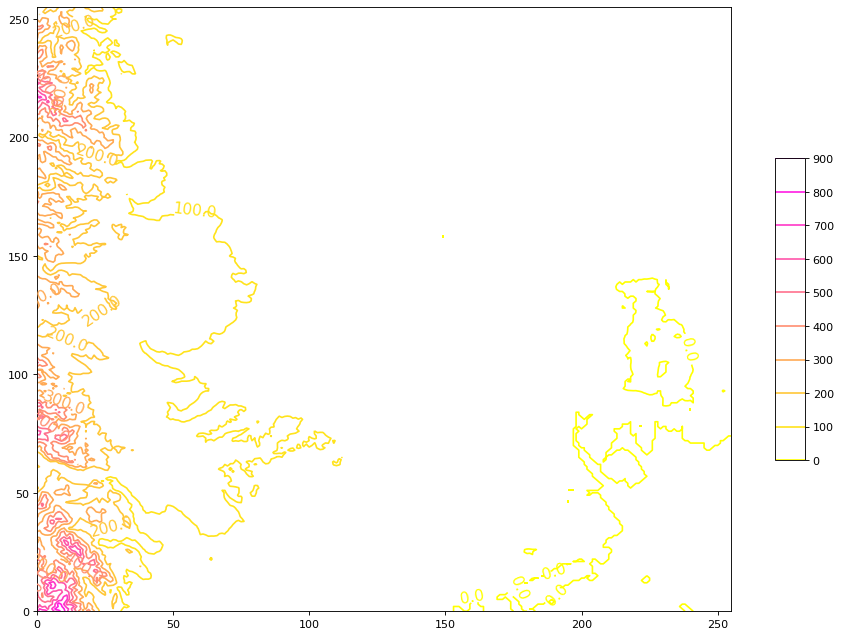

<AxesSubplot:>

<Figure size 432x288 with 0 Axes>

In [35]:
import requests
import string
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from io import StringIO
url="http://cyberjapandata.gsi.go.jp/xyz/dem/9/454/201.txt"
response=requests.get(url)
#標高値がない区画はとりあえず0mに置換する
#maptxt=string.replace(response.text,u'e',u'-0.0')
maptxt=response.text.replace(u'e',u'-0.0')
Z=pd.read_csv(StringIO(maptxt),header=None)
#X,Y軸のグリッドを生成
X,Y=np.meshgrid(np.linspace(0,255,256),np.linspace(255,0,256))
#標高100m間隔で等高線を描く
fig = plt.figure(figsize=(14, 10), dpi=80, facecolor='w', edgecolor='k')
elevation = range(0,1000,100)
cont = plt.contour(X, Y, Z, levels=elevation, cmap='spring_r')
cont.clabel(fmt='%1.1f', fontsize=14)

#ラベルをつける
cb = plt.colorbar(cont, shrink=0.5, aspect=10)

#plt.savefig('map.jpg', dpi=72)
plt.show()
machida["geometry"].plot(ax=ax)

背景にタイルを設定するには，地理院タイル一覧から必要なものを取得するとよい。
https://maps.gsi.go.jp/development/ichiran.html
タイルのチェックには，下記のWebサイトを用いる。
https://maps.gsi.go.jp/development/tileCoordCheck.html

In [36]:
tokyo.to_crs(epsg=3857)

,ward_ja,ward_en,area_ja,area_en,code,geometry,convex_hull,boundary,centroid,buffered,buffered_centroid
0,足立区,Adachi Ku,都区部,Tokubu,131211.0,"POLYGON ((139.82105 35.81508, 139.82168 35.814...","POLYGON ((139.80204 35.73857, 139.80143 35.738...","LINESTRING (139.82105 35.81508, 139.82168 35.8...",POINT (139.79508 35.77881),"POLYGON ((139.72806 35.78023, 139.72806 35.780...","POLYGON ((139.80508 35.77881, 139.80503 35.777..."
1,文京区,Bunkyo Ku,都区部,Tokubu,131059.0,"POLYGON ((139.76093 35.73221, 139.76100 35.732...","POLYGON ((139.76602 35.69964, 139.74587 35.702...","LINESTRING (139.76093 35.73221, 139.76100 35.7...",POINT (139.74728 35.71746),"POLYGON ((139.70791 35.71776, 139.70792 35.717...","POLYGON ((139.75728 35.71746, 139.75723 35.716..."
2,千代田区,Chiyoda Ku,都区部,Tokubu,131016.0,"POLYGON ((139.77014 35.70535, 139.77017 35.705...","POLYGON ((139.75802 35.66868, 139.74766 35.669...","LINESTRING (139.77014 35.70535, 139.77017 35.7...",POINT (139.75468 35.68764),"POLYGON ((139.72042 35.68841, 139.72042 35.688...","POLYGON ((139.76468 35.68764, 139.76463 35.686..."
3,台東区,Taito Ku,都区部,Tokubu,131067.0,"POLYGON ((139.80971 35.72814, 139.80971 35.727...","POLYGON ((139.78891 35.69470, 139.78254 35.696...","LINESTRING (139.80971 35.72814, 139.80971 35.7...",POINT (139.78598 35.71548),"POLYGON ((139.75407 35.72584, 139.75366 35.726...","POLYGON ((139.79598 35.71548, 139.79594 35.714..."
4,品川区,Shinagawa Ku,都区部,Tokubu,131091.0,"MULTIPOLYGON (((139.71920 35.64185, 139.71935 ...","POLYGON ((139.75597 35.58493, 139.73011 35.587...","MULTILINESTRING ((139.71920 35.64185, 139.7193...",POINT (139.73355 35.60970),"POLYGON ((139.68545 35.60851, 139.68543 35.608...","POLYGON ((139.74355 35.60970, 139.74350 35.608..."
5,江戸川区,Edogawa Ku,都区部,Tokubu,131237.0,"MULTIPOLYGON (((139.89044 35.75028, 139.89082 ...","POLYGON ((139.86614 35.63244, 139.84967 35.635...","MULTILINESTRING ((139.89044 35.75028, 139.8908...",POINT (139.87567 35.69242),"POLYGON ((139.82515 35.70872, 139.82513 35.708...","POLYGON ((139.88567 35.69242, 139.88562 35.691..."
6,新宿区,Shinjuku Ku,都区部,Tokubu,131041.0,"POLYGON ((139.72251 35.71227, 139.72250 35.712...","POLYGON ((139.71655 35.67343, 139.68767 35.681...","LINESTRING (139.72251 35.71227, 139.72250 35.7...",POINT (139.70897 35.70107),"POLYGON ((139.66351 35.72019, 139.66361 35.721...","POLYGON ((139.71897 35.70107, 139.71892 35.700..."
7,渋谷区,Shibuya Ku,都区部,Tokubu,131130.0,"POLYGON ((139.68399 35.69199, 139.68445 35.692...","POLYGON ((139.71033 35.64146, 139.70939 35.641...","LINESTRING (139.68399 35.69199, 139.68445 35.6...",POINT (139.69627 35.66788),"POLYGON ((139.65175 35.67292, 139.65170 35.673...","POLYGON ((139.70627 35.66788, 139.70623 35.666..."
8,北区,Kita Ku,都区部,Tokubu,131172.0,"POLYGON ((139.69767 35.79845, 139.69828 35.798...","POLYGON ((139.75993 35.73158, 139.72404 35.739...","LINESTRING (139.69767 35.79845, 139.69828 35.7...",POINT (139.72892 35.76590),"POLYGON ((139.67949 35.78848, 139.67950 35.788...","POLYGON ((139.73892 35.76590, 139.73887 35.764..."
9,豊島区,Toshima Ku,都区部,Tokubu,131164.0,"POLYGON ((139.71951 35.74504, 139.71950 35.744...","POLYGON ((139.72251 35.71227, 139.72016 35.712...","LINESTRING (139.71951 35.74504, 139.71950 35.7...",POINT (139.71163 35.73153),"POLYGON ((139.66806 35.73308, 139.66823 35.733...","POLYGON ((139.72163 35.73153, 139.72158 35.730..."


この目的のためには，contextilyというパッケージを用いる。

In [37]:
!pip install contextily
import contextily as ctx

/srv/conda/envs/notebook/lib/python3.7/site-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


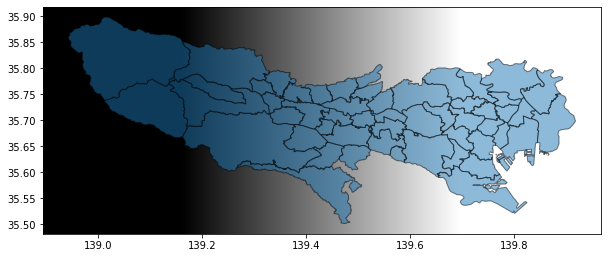

In [38]:
ax = tokyo.plot(figsize=(10, 10), alpha=0.5, edgecolor='k')
ctx.add_basemap(ax,source="201.png")

tokyoの各行には，`Shapely`のobjectの機能によって面積を表す属性areaが設定されている。この面積の大小によって色を変える。まずは，このareaの値を，GeoDataFrame`tokyo`のカラム`area`に設定する。

In [39]:
tokyo["area"]=tokyo.area

/srv/conda/envs/notebook/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


GeoDataFrameのあるカラムの値を用いて色分けしてプロットするには，第１引数にカラム名を指定する。

<AxesSubplot:>

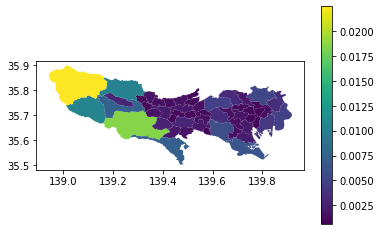

In [40]:
tokyo.plot("area",legend=True)

市区内を全て塗る必要がない場合は，重心のみをプロットするよう指定することもできる。その場合，カラムとして`centroid`をまず指定する。

In [41]:
tokyo["centroid"]=tokyo.centroid

/srv/conda/envs/notebook/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


そして，`set_geometry`により，"centroid"カラムを指定する。

In [42]:
tokyo = tokyo.set_geometry("centroid")

<AxesSubplot:>

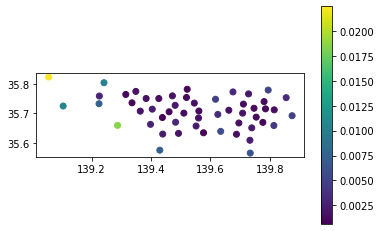

In [43]:
tokyo.plot("area",legend=True)

各市区の形と重心をあわせて表示したい場合は，重ねて表示する。

<AxesSubplot:>

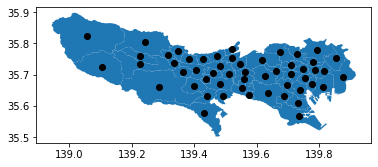

In [44]:
ax = tokyo["geometry"].plot()
tokyo["centroid"].plot(ax=ax, color="black")

多摩市の境界から20km以内にある市区を求める。まずは，多摩市を表すポリゴンを取得する。

In [45]:
tama=tokyo.loc[tokyo['ward_ja']=='多摩市',"geometry"]

`tokyo`内の各市区の境界から，30000フィート（約10キロメートル）のバッファーを設ける。その結果を，`tokyo`の"buffered"カラムに記録する。さらに，各市区の重心から30000フィートのバッファーを設けて，"buffered_centroid"に記録する。

In [46]:
tokyo["buffered"]=tokyo.buffer(0.01)
#tokyo["buffered_centroid"]=tokyo["centroid"].buffer(1)

<AxesSubplot:>

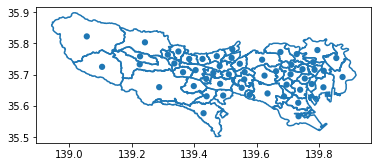

In [47]:
ax=tokyo["buffered"].plot()
tokyo["boundary"].plot(ax=ax)